# 1. Introduction

**Information about dataset**: 

Datasource: [Telecom Customer Churn](https://www.mavenanalytics.io/blog/maven-churn-challenge) <br>
This dataset contains 2 tables, in CSV format:

- The Customer Churn table contains information on all 7,043 customers from a Telecommunications company in California in Q2 2022
- Each record represents one customer, and contains details about their demographics, location, tenure, subscription services, status for the quarter (joined, stayed, or churned), and more!
- The Zip Code Population table contains complimentary information on the estimated populations for the California zip codes in the Customer Churn table 

Data dictionary : [Dictionary](https://docs.google.com/spreadsheets/d/1jCw0aVRpzJXYXgSVc6-bp-UE8mwIR_s8h-c8eWW-c_U/edit?usp=sharing)

## 1.1 Business Objective
The business objective is to identify the churn reasons that are provided by the churned customers and further analyze those reasons with other factors available in the dataset to create data-driven conclusions. This is to ensure that customer needs are satisfied and minimizes the churn rate of the current customer base as well as potentially attracting new customers by making improvements to the current packages offered

## 1.2 Questions and Insights for Analysis Purpose¶
- What is the average tenure in months for churned and staying customers? What is their contract period?
- What are the churn categories & reasons for customers that subscribe to phone service and/or internet service? Do they subscribe to any promotional offers?
- Investigate the churn reasons based on the data given so that a stronger conclusion can be formed and improvements can be made.

# 2. Data Quality Asessement & Data Cleaning

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

## Load Data

In [2]:
df = pd.read_csv("telecom_customer_churn.csv")

In [3]:
df1 = pd.read_csv("telecom_zipcode_population.csv")

## Merge Data

In [4]:
df = pd.merge(df, df1[['Zip Code', 'Population']], on='Zip Code', how='left')

## About Data

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 39 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Customer ID                        7043 non-null   object 
 1   Gender                             7043 non-null   object 
 2   Age                                7043 non-null   int64  
 3   Married                            7043 non-null   object 
 4   Number of Dependents               7043 non-null   int64  
 5   City                               7043 non-null   object 
 6   Zip Code                           7043 non-null   int64  
 7   Latitude                           7043 non-null   float64
 8   Longitude                          7043 non-null   float64
 9   Number of Referrals                7043 non-null   int64  
 10  Tenure in Months                   7043 non-null   int64  
 11  Offer                              3166 non-null   objec

In [7]:
df.head()

,Customer ID,Gender,Age,Married,Number of Dependents,City,Zip Code,Latitude,Longitude,Number of Referrals,...,Monthly Charge,Total Charges,Total Refunds,Total Extra Data Charges,Total Long Distance Charges,Total Revenue,Customer Status,Churn Category,Churn Reason,Population
0,0002-ORFBO,Female,37,Yes,0,Frazier Park,93225,34.827662,-118.999073,2,...,65.6,593.30,0.00,0,381.51,974.81,Stayed,NaN,NaN,4498
1,0003-MKNFE,Male,46,No,0,Glendale,91206,34.162515,-118.203869,0,...,-4.0,542.40,38.33,10,96.21,610.28,Stayed,NaN,NaN,31297
2,0004-TLHLJ,Male,50,No,0,Costa Mesa,92627,33.645672,-117.922613,0,...,73.9,280.85,0.00,0,134.60,415.45,Churned,Competitor,Competitor had better devices,62069
3,0011-IGKFF,Male,78,Yes,0,Martinez,94553,38.014457,-122.115432,1,...,98.0,1237.85,0.00,0,361.66,1599.51,Churned,Dissatisfaction,Product dissatisfaction,46677
4,0013-EXCHZ,Female,75,Yes,0,Camarillo,93010,34.227846,-119.079903,3,...,83.9,267.40,0.00,0,22.14,289.54,Churned,Dissatisfaction,Network reliability,42853


## Check Duplicate 

In [13]:
print(df.duplicated().sum())


0


## Missing Value

In [14]:
print(df.isna().sum())

Customer ID                             0
Gender                                  0
Age                                     0
Married                                 0
Number of Dependents                    0
City                                    0
Zip Code                                0
Latitude                                0
Longitude                               0
Number of Referrals                     0
Tenure in Months                        0
Offer                                3877
Phone Service                           0
Avg Monthly Long Distance Charges     682
Multiple Lines                        682
Internet Service                        0
Internet Type                        1526
Avg Monthly GB Download              1526
Online Security                      1526
Online Backup                        1526
Device Protection Plan               1526
Premium Tech Support                 1526
Streaming TV                         1526
Streaming Movies                  

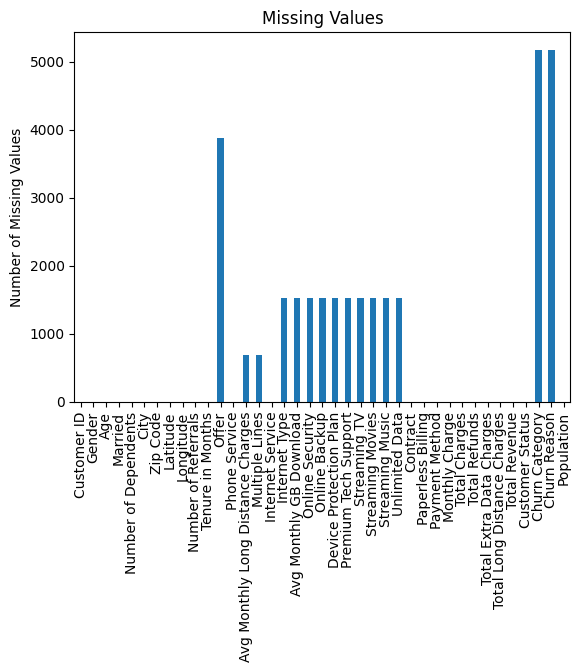

In [15]:
# Plot number of missing values for each variables
df.isna().sum().plot(kind='bar')
plt.title('Missing Values')
plt.ylabel('Number of Missing Values')
plt.show()

## Describe Data

In [16]:
df.describe()

,Age,Number of Dependents,Zip Code,Latitude,Longitude,Number of Referrals,Tenure in Months,Avg Monthly Long Distance Charges,Avg Monthly GB Download,Monthly Charge,Total Charges,Total Refunds,Total Extra Data Charges,Total Long Distance Charges,Total Revenue,Population
count,7043.000000,7043.000000,7043.000000,7043.000000,7043.000000,7043.000000,7043.000000,6361.000000,5517.000000,7043.000000,7043.000000,7043.000000,7043.000000,7043.000000,7043.000000,7043.000000
mean,46.509726,0.468692,93486.070567,36.197455,-119.756684,1.951867,32.386767,25.420517,26.189958,63.596131,2280.381264,1.962182,6.860713,749.099262,3034.379056,22139.603294
std,16.750352,0.962802,1856.767505,2.468929,2.154425,3.001199,24.542061,14.200374,19.586585,31.204743,2266.220462,7.902614,25.104978,846.660055,2865.204542,21152.392837
min,19.000000,0.000000,90001.000000,32.555828,-124.301372,0.000000,1.000000,1.010000,2.000000,-10.000000,18.800000,0.000000,0.000000,0.000000,21.360000,11.000000
25%,32.000000,0.000000,92101.000000,33.990646,-121.788090,0.000000,9.000000,13.050000,13.000000,30.400000,400.150000,0.000000,0.000000,70.545000,605.610000,2344.000000
50%,46.000000,0.000000,93518.000000,36.205465,-119.595293,0.000000,29.000000,25.690000,21.000000,70.050000,1394.550000,0.000000,0.000000,401.440000,2108.640000,17554.000000
75%,60.000000,0.000000,95329.000000,38.161321,-117.969795,3.000000,55.000000,37.680000,30.000000,89.750000,3786.600000,0.000000,0.000000,1191.100000,4801.145000,36125.000000
max,80.000000,9.000000,96150.000000,41.962127,-114.192901,11.000000,72.000000,49.990000,85.000000,118.750000,8684.800000,49.790000,150.000000,3564.720000,11979.340000,105285.000000


In [18]:
df.nunique()

Customer ID                          7043
Gender                                  2
Age                                    62
Married                                 2
Number of Dependents                   10
City                                 1106
Zip Code                             1626
Latitude                             1626
Longitude                            1625
Number of Referrals                    12
Tenure in Months                       72
Offer                                   5
Phone Service                           2
Avg Monthly Long Distance Charges    3583
Multiple Lines                          2
Internet Service                        2
Internet Type                           3
Avg Monthly GB Download                49
Online Security                         2
Online Backup                           2
Device Protection Plan                  2
Premium Tech Support                    2
Streaming TV                            2
Streaming Movies                  

In [5]:
from ydata_profiling import ProfileReport

In [10]:
%pip install ipywidgets

  Using cached ipywidgets-8.1.8-py3-none-any.whl.metadata (2.4 kB)
  Using cached widgetsnbextension-4.0.15-py3-none-any.whl.metadata (1.6 kB)
  Using cached jupyterlab_widgets-3.0.16-py3-none-any.whl.metadata (20 kB)
Using cached ipywidgets-8.1.8-py3-none-any.whl (139 kB)
Using cached jupyterlab_widgets-3.0.16-py3-none-any.whl (914 kB)
Using cached widgetsnbextension-4.0.15-py3-none-any.whl (2.2 MB)

   -------------------------- ------------- 2/3 [ipywidgets]
   -------------------------- ------------- 2/3 [ipywidgets]
   -------------------------- ------------- 2/3 [ipywidgets]
   -------------------------- ------------- 2/3 [ipywidgets]
   ---------------------------------------- 3/3 [ipywidgets]

Note: you may need to restart the kernel to use updated packages.


In [6]:
profile = ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 39/39 [00:01<00:00, 35.70it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Dealing with Missing Data

**The dataset does not contain any genuine missing values**
- **'Offer' Column**: NA values represent "None", but pandas interpreted them as NA. $\rightarrow$ Converted to string format.
- **'Avg Monthly Long Distance Charges' & 'Avg Monthly GB Download'**: NA values indicate missing information because the customer did not subscribe to Phone Service. $\rightarrow$ Filled with 0 as per the data dictionary.
- **'Churn Category' & 'Churn Reason'**: NA values depend on the 'Churn Status'. $\rightarrow$ This does not affect the analysis; NA values are retained to accurately reflect the data structure. They can be analyzed separately or removed if necessary.
- **Service-Specific Columns**: NA values in 'Multiple Lines' (No Phone Service) and columns like 'Internet Type', 'Streaming...', 'Unlimited Data' (No Internet Service) represent missing information.
    - Handling: While these could be filled with "No" per the data dictionary, this would create ambiguity with genuine "No" values (from customers who do subscribe to the service).
    - Strategy: Split the data into 3 subsets for in-depth analysis:
        - Customers using full services.
        - Customers using only Phone Service.
        - Customers using only Internet Service.

**Conclusion**: Perform analysis on the full dataset for a general overview and on the subsets for in-depth insights.    

In [60]:
#Fill na in Offer column to string "None"
df['Offer'] = df['Offer'].fillna('None')

In [61]:
#Fill na in Avg Monthly Long Distance Charges and Avg Monthly GB Download columns to 0 value
df['Avg Monthly Long Distance Charges'] = df['Avg Monthly Long Distance Charges'].fillna(0)
df['Avg Monthly GB Download'] = df['Avg Monthly GB Download'].fillna(0)

In [63]:
#Split the data into 3 subsets for in-depth analysis
#Full service 
full_service = df[(df['Phone Service']== 'Yes') & (df['Internet Service'] == 'Yes')]
#Phone service 
phone_service = df[(df['Phone Service']== 'Yes') & (df['Internet Service'] == 'No')]
#Internet service
internet_service = df[(df['Phone Service']== 'No') & (df['Internet Service'] == 'Yes')]

Enriched Data 

In [41]:
def tenure_category(months):
    if 1 <= months <= 6:
        return '1 - 6 Months'
    elif 7 <= months <= 12:
        return '7 - 12 Months'
    elif 13 <= months <= 24:
        return '1 - 2 Years'
    elif 25 <= months <= 36:
        return '2 - 3 Years'
    elif 37 <= months <= 48:
        return '3 - 4 Years'
    elif 49 <= months <= 60:
        return '4 - 5 Years'
    elif 61 <= months <= 72:
        return '5 - 6 Years'
    else:
        return '> 6 Years'
df['Tenure Category'] = df['Tenure in Months'].apply(tenure_category)
tenure_order = [
    '1 - 6 Months',
    '7 - 12 Months',
    '1 - 2 Years',
    '2 - 3 Years',
    '3 - 4 Years',
    '4 - 5 Years',
    '5 - 6 Years'
]
#Add Tenure Category Column in df
df['Tenure Category'] = pd.Categorical(
    df['Tenure Category'],
    categories=tenure_order,
    ordered=True
)

# 3. Exploratory Data Analysis

In this section, I will perform an analysis on the full dataset to gain a general overview.

## Univariate Analysis

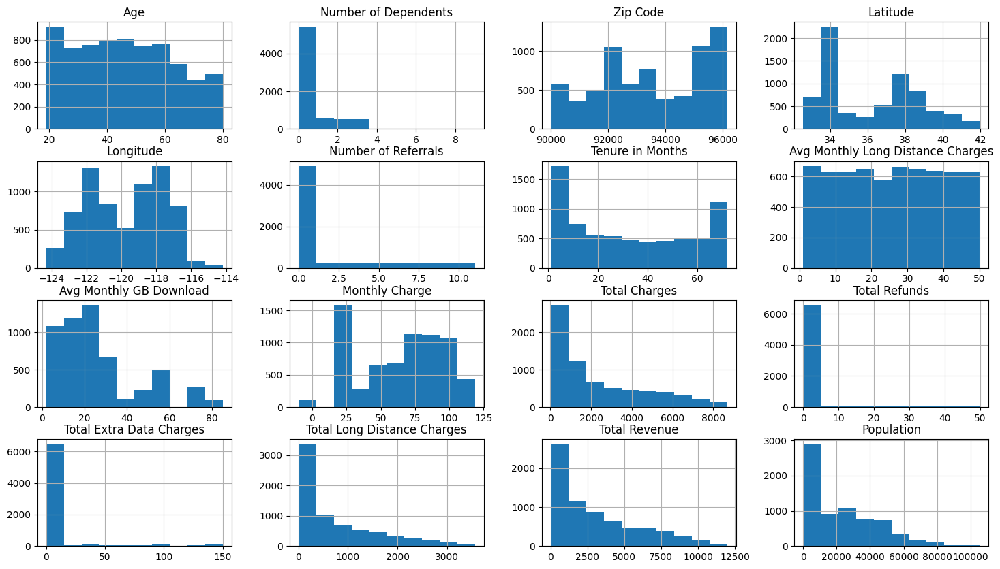

In [5]:
#Plot histogram
df.hist(figsize=(18, 10))
plt.show()

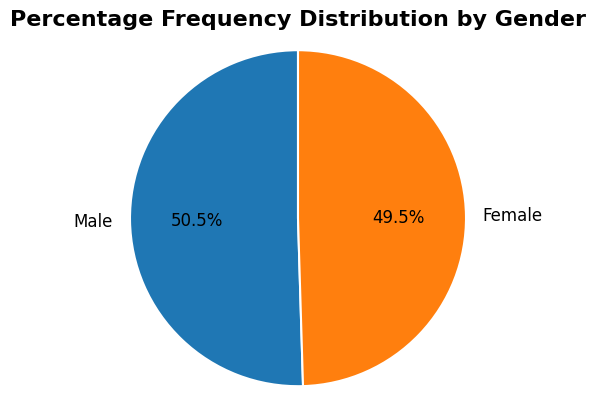

In [9]:
#plot pie chart to describe Percentage Frequency Distribution by Gender
gender_counts = df['Gender'].value_counts()
plt.pie(gender_counts,
        labels=gender_counts.index,
        autopct='%1.1f%%',
        startangle=90,
        textprops={'fontsize': 12}, # Increase font size for labels
        wedgeprops={'edgecolor': 'white', 'linewidth': 1.5})
plt.title('Percentage Frequency Distribution by Gender', fontsize=16, fontweight='bold')
plt.axis('equal')
# Display the final plot
plt.show()

Text(0, 0.5, 'City')

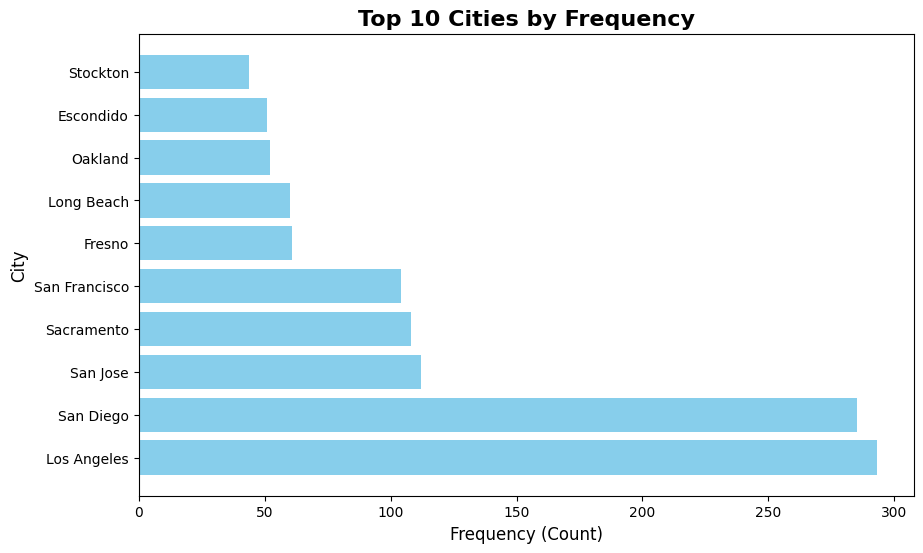

In [12]:
top_10_cities = df['City'].value_counts().head(10)
plt.figure(figsize=(10, 6))
bars = plt.barh(top_10_cities.index, top_10_cities.values, color='skyblue')
plt.title('Top 10 Cities by Frequency', fontsize=16, fontweight='bold')
plt.xlabel('Frequency (Count)', fontsize=12)
plt.ylabel('City', fontsize=12)

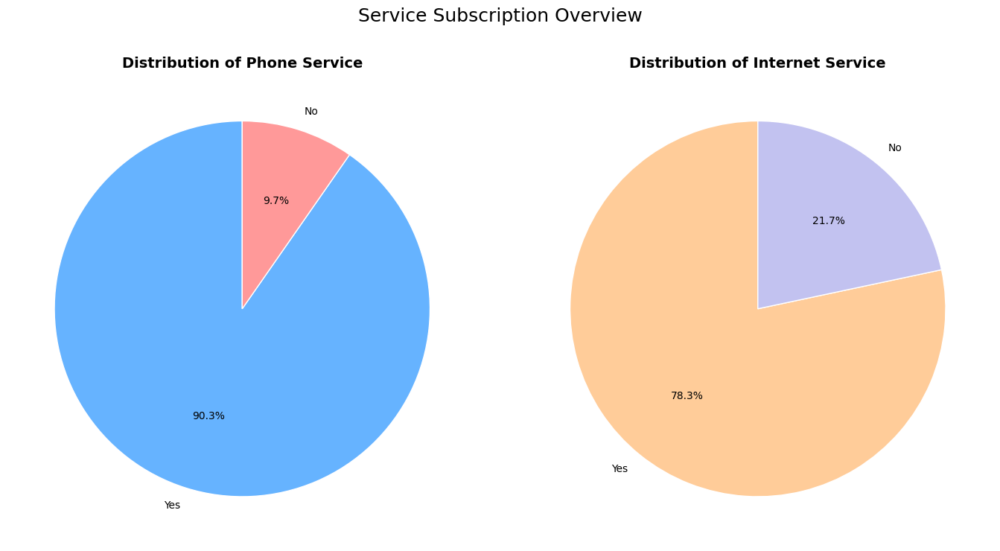

In [14]:
phone_counts = df['Phone Service'].value_counts()
internet_counts = df['Internet Service'].value_counts()
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 7))
axes[0].pie(phone_counts, 
            labels=phone_counts.index, 
            autopct='%1.1f%%', 
            startangle=90,
            colors=['#66b3ff', '#ff9999', '#99ff99'], # Màu tùy chọn
            wedgeprops={'edgecolor': 'white'})
axes[0].set_title('Distribution of Phone Service', fontsize=14, fontweight='bold')

axes[1].pie(internet_counts, 
            labels=internet_counts.index, 
            autopct='%1.1f%%', 
            startangle=90,
            colors=['#ffcc99', '#c2c2f0', '#ffb3e6'], 
            wedgeprops={'edgecolor': 'white'})
axes[1].set_title('Distribution of Internet Service', fontsize=14, fontweight='bold')

plt.suptitle('Service Subscription Overview', fontsize=18, y=1.05)
plt.tight_layout()
plt.show()

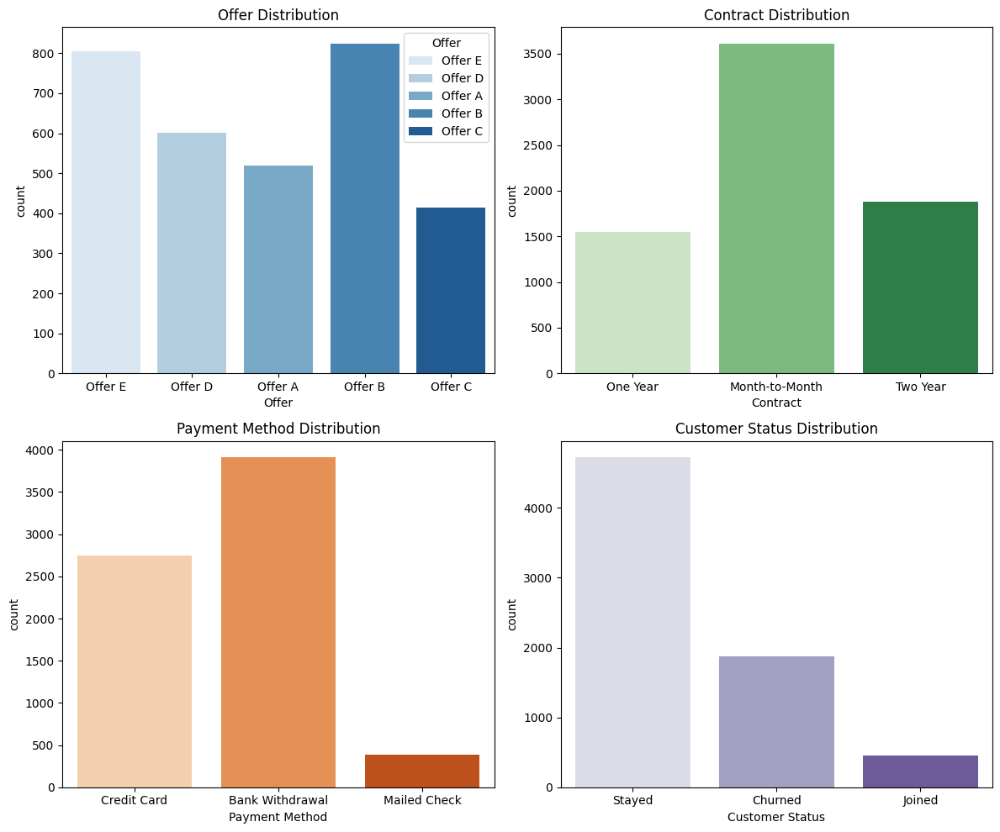

In [7]:

fig, axes = plt.subplots(2, 2, figsize=(12, 10))


sns.countplot(x='Offer', data=df[df['Offer'] != 'None'], ax=axes[0, 0], palette="Blues", hue='Offer')
axes[0, 0].set_title('Offer Distribution')

sns.countplot(x='Contract', data=df, ax=axes[0, 1], palette="Greens", hue='Contract')
axes[0, 1].set_title('Contract Distribution')

sns.countplot(x='Payment Method', data=df, ax=axes[1, 0], palette="Oranges",hue='Payment Method')
axes[1, 0].set_title('Payment Method Distribution')

sns.countplot(x='Customer Status', data=df, ax=axes[1, 1], palette="Purples", hue='Customer Status')
axes[1, 1].set_title('Customer Status Distribution')
plt.tight_layout()
plt.show()


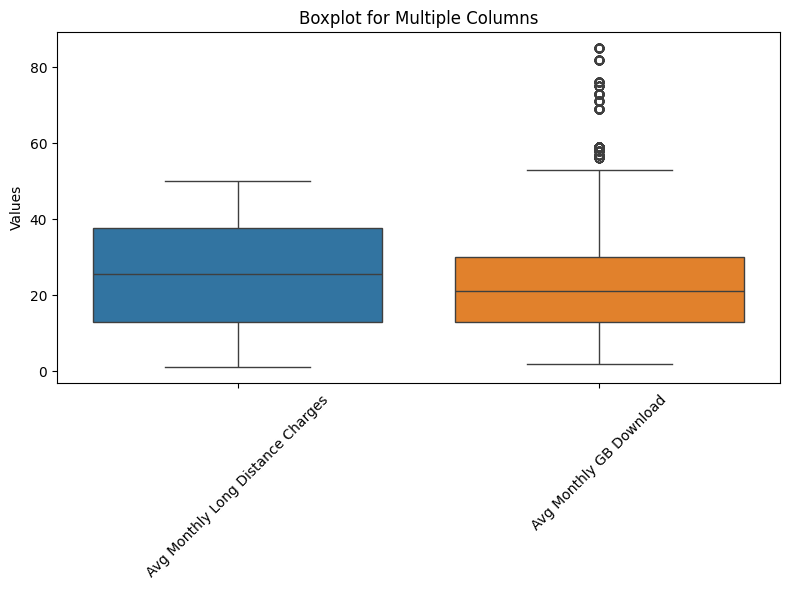

In [15]:

columns_to_plot = ['Avg Monthly Long Distance Charges','Avg Monthly GB Download']
plt.figure(figsize=(8, 6))
sns.boxplot(data=df[columns_to_plot])
plt.title('Boxplot for Multiple Columns')
plt.xticks(rotation=45)  # Xoay tên cột để dễ đọc
plt.ylabel('Values')
plt.tight_layout()
plt.show()

In [20]:
Q1 = df['Avg Monthly GB Download'].quantile(0.25)
Q3 = df['Avg Monthly GB Download'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers_avg_monthly_gb_download = df[ (df['Avg Monthly GB Download'] > upper_bound)]

print(outliers_avg_monthly_gb_download .shape[0])
outliers_avg_monthly_gb_download 


649


,Customer ID,Gender,Age,Married,Number of Dependents,City,Zip Code,Latitude,Longitude,Number of Referrals,...,Monthly Charge,Total Charges,Total Refunds,Total Extra Data Charges,Total Long Distance Charges,Total Revenue,Customer Status,Churn Category,Churn Reason,Population
5,0013-MHZWF,Female,23,No,3,Midpines,95345,37.581496,-119.972762,0,...,69.40,571.45,0.0,0,150.93,722.38,Stayed,NaN,NaN,433
11,0017-IUDMW,Female,25,Yes,2,Sunnyvale,94086,37.378541,-122.020456,2,...,116.80,8456.75,0.0,0,1152.72,9609.47,Stayed,NaN,NaN,64010
26,0036-IHMOT,Female,37,Yes,3,Parlier,93648,36.622237,-119.521126,10,...,103.70,5656.75,0.0,20,1927.20,7603.95,Stayed,NaN,NaN,12587
41,0068-FIGTF,Female,20,No,0,Fremont,94539,37.516791,-121.899117,0,...,78.20,2078.95,0.0,0,1320.57,3399.52,Stayed,NaN,NaN,46917
50,0083-PIVIK,Male,25,No,0,Tulelake,96134,41.813521,-121.492666,0,...,81.25,5567.55,0.0,40,351.36,5958.91,Stayed,NaN,NaN,2595
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6973,9895-VFOXH,Female,19,No,0,Scotia,95565,40.440636,-124.098739,0,...,24.40,24.40,0.0,10,0.00,34.40,Joined,NaN,NaN,1125
6974,9896-UYMIE,Male,27,No,0,Valley Ford,94972,38.339996,-122.935056,0,...,114.30,7383.70,0.0,0,285.12,7668.82,Stayed,NaN,NaN,66
7025,9968-FFVVH,Male,20,No,0,Potter Valley,95469,39.408634,-123.045516,0,...,68.80,4111.35,0.0,0,2417.31,6528.66,Stayed,NaN,NaN,1884
7038,9987-LUTYD,Female,20,No,0,La Mesa,91941,32.759327,-116.997260,0,...,55.15,742.90,0.0,0,606.84,1349.74,Stayed,NaN,NaN,44652


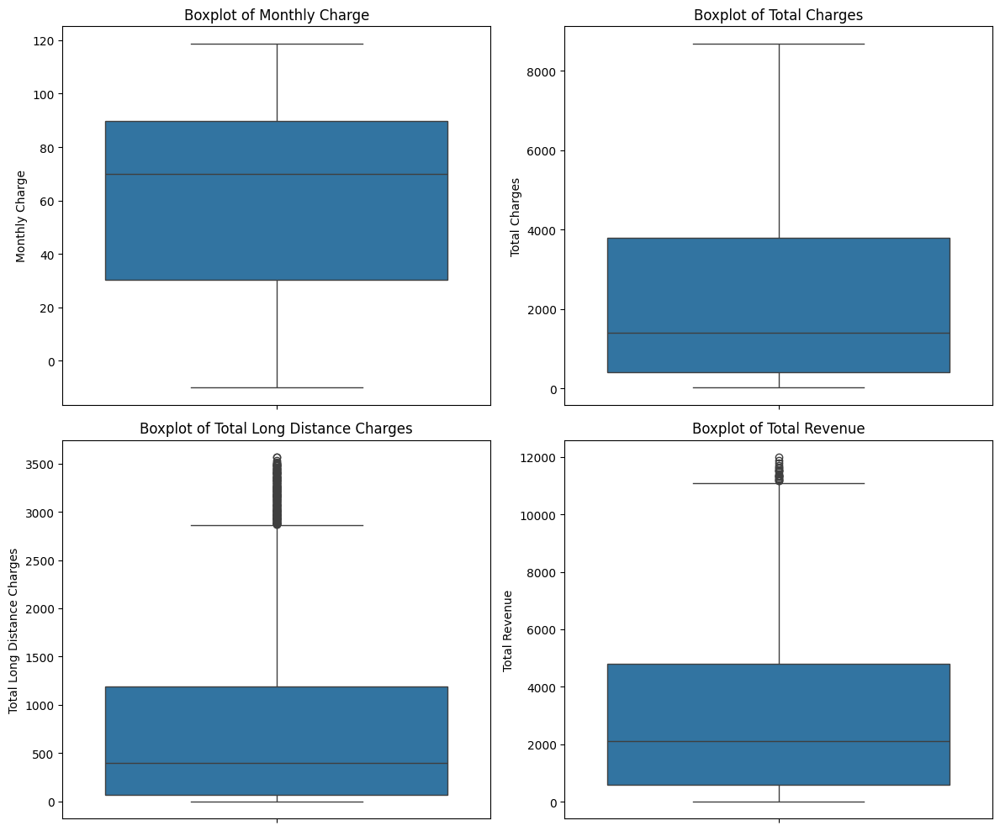

In [16]:
fig, axes = plt.subplots(2, 2, figsize=(12, 10))
sns.boxplot(data=df['Monthly Charge'], ax=axes[0, 0])
axes[0, 0].set_title('Boxplot of Monthly Charge')
sns.boxplot(data=df['Total Charges'], ax=axes[0, 1])
axes[0, 1].set_title('Boxplot of Total Charges')

sns.boxplot(data=df['Total Long Distance Charges'], ax=axes[1, 0])
axes[1, 0].set_title('Boxplot of Total Long Distance Charges')

sns.boxplot(data=df['Total Revenue'], ax=axes[1, 1])
axes[1, 1].set_title('Boxplot of Total Revenue')

plt.tight_layout()
plt.show()

In [8]:
# Calculate Q1 (25%), Q3 (75%) and IQR (Interquartile Range)
Q1 = df['Total Long Distance Charges'].quantile(0.25)
Q3 = df['Total Long Distance Charges'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers_total_long_distance_charges = df[ (df['Total Long Distance Charges'] > upper_bound)]

print(outliers_total_long_distance_charges.shape[0])
outliers_total_long_distance_charges

196


,Customer ID,Gender,Age,Married,Number of Dependents,City,Zip Code,Latitude,Longitude,Number of Referrals,...,Monthly Charge,Total Charges,Total Refunds,Total Extra Data Charges,Total Long Distance Charges,Total Revenue,Customer Status,Churn Category,Churn Reason,Population
32,0052-DCKON,Male,28,Yes,0,Los Angeles,90063,34.044271,-118.185237,9,...,-2.00,7942.15,0.00,0,2888.82,10830.97,Stayed,NaN,NaN,55668
76,0123-CRBRT,Female,62,Yes,0,Monterey Park,91755,34.049172,-118.115022,1,...,88.10,5526.75,0.00,0,2878.59,8405.34,Stayed,NaN,NaN,26933
81,0130-SXOUN,Male,55,No,0,Glenhaven,95443,39.045246,-122.743181,0,...,89.40,5976.90,36.02,40,3219.48,9200.36,Stayed,NaN,NaN,175
95,0164-APGRB,Female,56,No,0,Calistoga,94515,38.629618,-122.593216,0,...,114.90,8496.70,0.00,0,3482.64,11979.34,Stayed,NaN,NaN,7384
152,0254-FNMCI,Female,19,No,0,Downey,90241,33.940884,-118.128628,0,...,109.90,7624.20,0.00,0,3017.52,10641.72,Stayed,NaN,NaN,40152
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6753,9586-JGQKH,Female,61,Yes,0,Cathedral City,92234,33.829583,-116.474131,8,...,105.40,6794.75,32.24,0,3152.64,9915.15,Stayed,NaN,NaN,43141
6932,9835-ZIITK,Male,66,Yes,0,Campbell,95008,37.279689,-121.954567,1,...,110.85,7491.75,0.00,0,3225.42,10717.17,Churned,Competitor,Competitor made better offer,44976
6994,9926-PJHDQ,Female,45,Yes,0,Kingsburg,93631,36.478239,-119.521370,5,...,76.80,5468.45,0.00,90,3129.84,8688.29,Stayed,NaN,NaN,14088
7018,9958-MEKUC,Male,26,Yes,2,Pacifica,94044,37.573633,-122.455167,1,...,103.95,7517.70,0.00,0,3306.96,10824.66,Stayed,NaN,NaN,38885


In [42]:
# Calculate Q1 (25%), Q3 (75%) and IQR (Interquartile Range)
Q1 = df['Total Revenue'].quantile(0.25)
Q3 = df['Total Revenue'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers = df[ (df['Total Revenue'] > upper_bound)]

print(outliers.shape[0])
outliers
customer_vip = outliers

21


## Bivariate-Multivariate Analysis

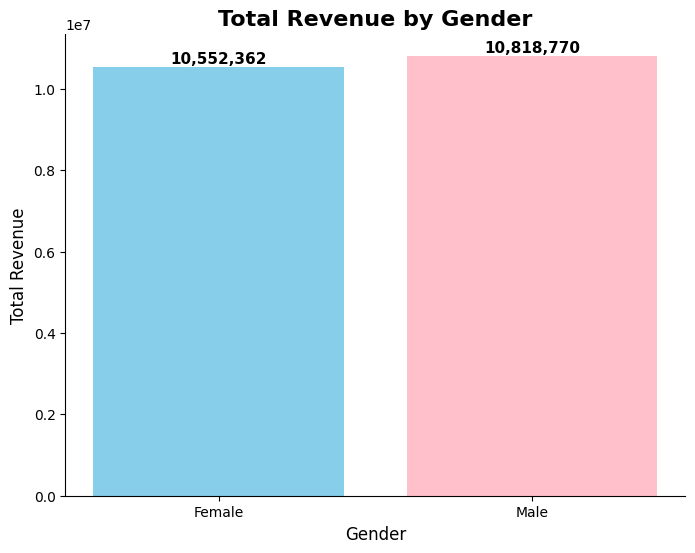

In [10]:
revenue_by_gender = df.groupby('Gender')['Total Revenue'].sum()
plt.figure(figsize=(8, 6))
bars = plt.bar(revenue_by_gender.index, revenue_by_gender.values, color=['skyblue', 'pink'])
plt.title('Total Revenue by Gender', fontsize=16, fontweight='bold')
plt.xlabel('Gender', fontsize=12)
plt.ylabel('Total Revenue', fontsize=12)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height, # Get the position for number above middle bar
             f'{height:,.0f}', 
             ha='center', va='bottom', fontsize=11, fontweight='bold')
plt.show()

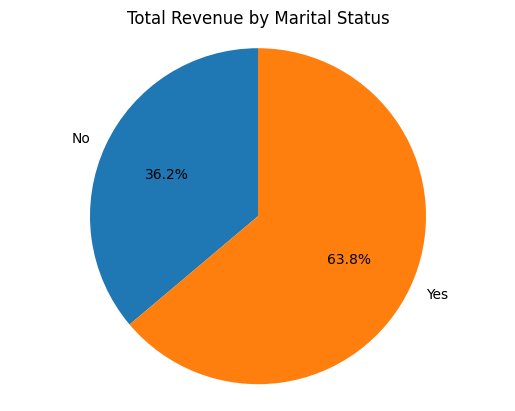

In [12]:
revenue_by_status = (df.groupby('Married')['Total Revenue'].sum())
plt.figure()
plt.pie(
    revenue_by_status,
    labels=revenue_by_status.index,
    autopct='%1.1f%%',
    startangle=90
)
plt.title('Total Revenue by Marital Status')
plt.axis('equal')
# Show the chart
plt.show()


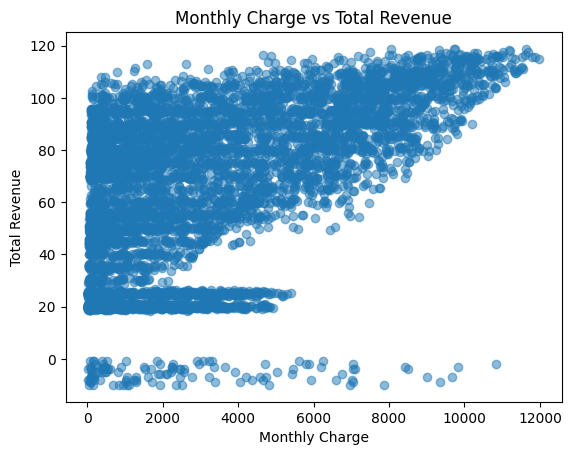

In [16]:
plt.figure()
plt.scatter(
    df['Total Revenue'],
    df['Monthly Charge'],
    alpha=0.5
)
plt.xlabel('Monthly Charge')
plt.ylabel('Total Revenue')
plt.title('Monthly Charge vs Total Revenue')
plt.show()

Monthly Charge shows a strong positive relationship with Total Revenue. However, a significant group of customers generates low or even negative revenue, regardless of their Monthly Charges, likely due to early churn or high refunds.

Additionally, some low Monthly Charge customers still produce high revenue,
suggesting long tenure or high usage-based charges.


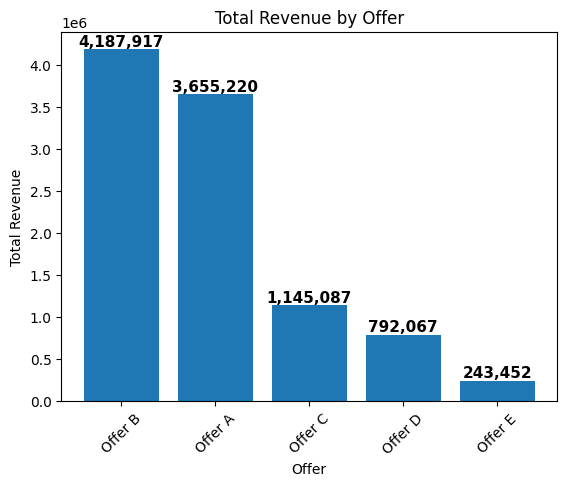

In [7]:
df_filtered = df[df['Offer'] != 'None']
revenue_by_offer = (
    df_filtered
    .groupby('Offer')['Total Revenue']
    .sum()
    .sort_values(ascending=False)
)

#  Plot bar chart
plt.figure()
bars= plt.bar(
    revenue_by_offer.index,
    revenue_by_offer.values
)
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height, # Get the position for number above middle bar
             f'{height:,.0f}', 
             ha='center', va='bottom', fontsize=11, fontweight='bold')
plt.xlabel('Offer')
plt.ylabel('Total Revenue')
plt.title('Total Revenue by Offer')
plt.xticks(rotation=45)
plt.show()

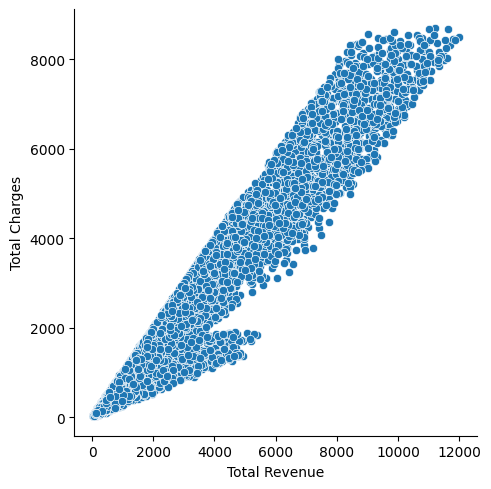

In [8]:
sns.relplot(data=df, x='Total Revenue', y='Total Charges')
plt.show()

Total Charges and Total Revenue exhibit a strong positive linear relationship.
This confirms that revenue is largely driven by accumulated charges, with refunds introducing moderate variability but not disrupting the overall trend.

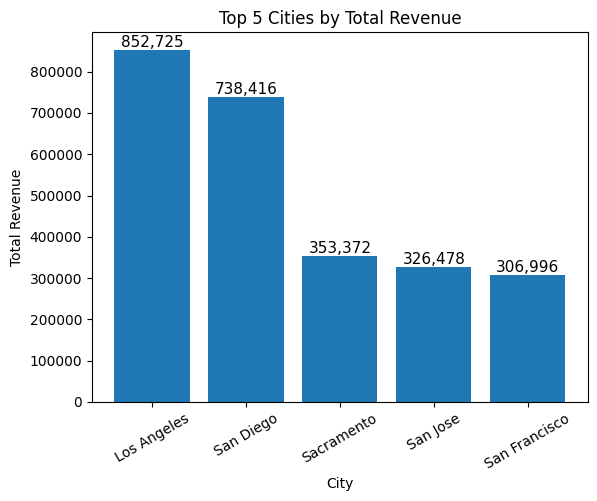

In [10]:
top5_city_revenue = (df.groupby('City')['Total Revenue'].sum().sort_values(ascending=False).head(5))
plt.figure()

bars = plt.bar(
    top5_city_revenue.index,
    top5_city_revenue.values
)

# Add labels and title
plt.xlabel('City')
plt.ylabel('Total Revenue')
plt.title('Top 5 Cities by Total Revenue')
# Rotate x labels for readability
plt.xticks(rotation=30)
# Add value labels on top of bars
for bar in bars:
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        height,
        f'{height:,.0f}',
        ha='center',
        va='bottom',
        fontsize=11,
    )

plt.show()

## Churn Analysis

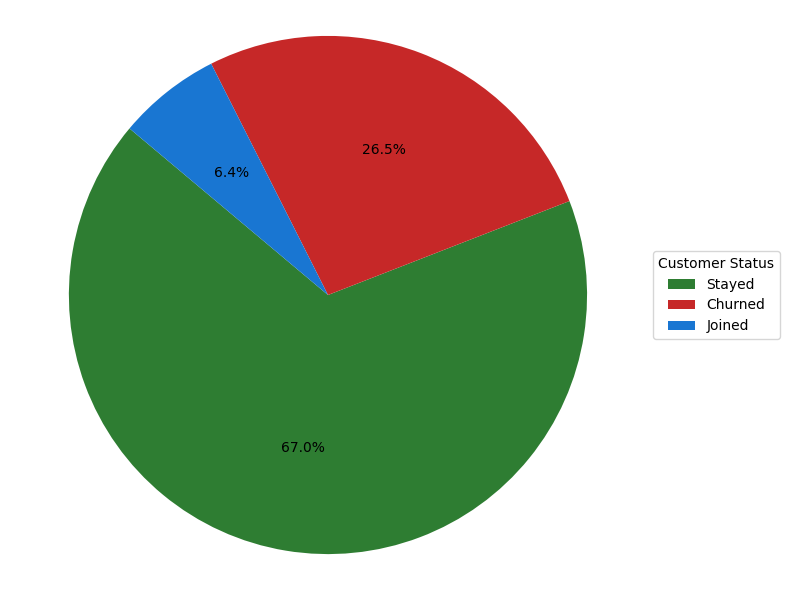

In [57]:
status_counts = df['Customer Status'].value_counts()
# Define color mapping
color_map = {
    'Stayed': '#2E7D32',
    'Joined': '#1976D2',
    'Churned': '#C62828'
}

# Map colors in the same order as status_counts
colors = [color_map[status] for status in status_counts.index]
status_counts = df['Customer Status'].value_counts()
plt.figure(figsize=(8, 6))
plt.pie(status_counts,  autopct='%1.1f%%', startangle=140, colors=colors)
plt.legend(
    status_counts.index,
    title="Customer Status",
    loc="center left",
    bbox_to_anchor=(1, 0, 0.5, 1)
)
plt.axis('equal')  # Đảm bảo biểu đồ là hình tròn
plt.tight_layout()
plt.show()

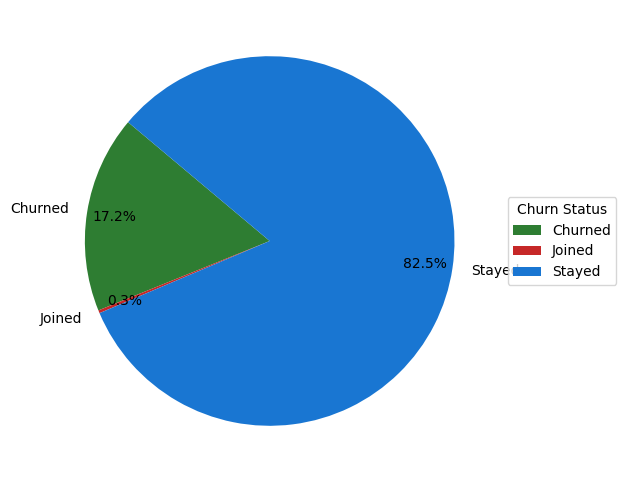

In [58]:
revenue_by_status = df.groupby('Customer Status')['Total Revenue'].sum()
plt.figure(figsize=(8, 6))
plt.pie(
    revenue_by_status,
    labels=revenue_by_status.index,
    autopct='%1.1f%%',
    startangle=140,
    colors=colors,
    pctdistance=0.85  )
plt.legend(
    revenue_by_status.index,
    title="Churn Status",
    loc="center left",
    bbox_to_anchor=(1, 0, 0.5, 1)
)

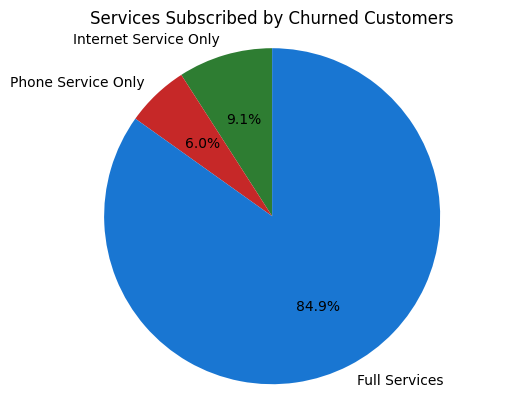

In [64]:
labels = [
    'Internet Service Only',
    'Phone Service Only',
    'Full Services'
]
sizes = [
    len(internet_service[internet_service['Customer Status'] == 'Churned']),
    len(phone_service[phone_service['Customer Status'] == 'Churned']),
    len(full_service[full_service['Customer Status'] == 'Churned'])
]
plt.figure()
plt.pie(
    sizes,
    labels=labels,
    autopct='%1.1f%%',
    startangle=90,
    colors=colors
)

plt.title('Services Subscribed by Churned Customers')
plt.axis('equal') 
plt.show()

**Insight**:

Services subscribed by customers: Out of customers that have churned from the company, 84.8% of these customers are subscribed to both phone and internet services, whereas the remaining 9.09% and 6.11% are subscribed to internet service only and phone service only respectively.


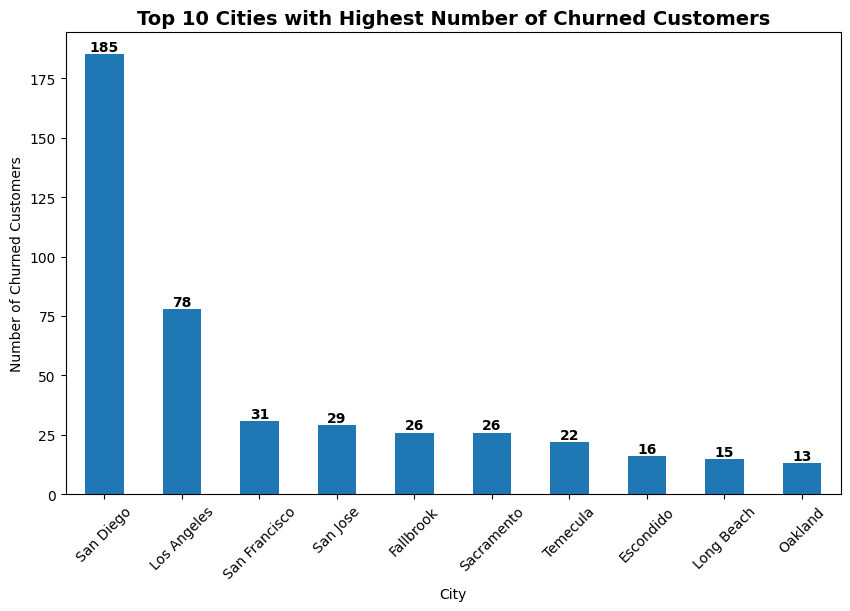

In [70]:
ax = (
    df[df['Customer Status'] == 'Churned']
    .groupby('City')
    .size()
    .sort_values(ascending=False)
    .head(10)
    .plot(
        kind='bar',
        figsize=(10, 6)
    )
)

plt.title(
    'Top 10 Cities with Highest Number of Churned Customers',
    fontsize=14,
    fontweight='bold'
)
plt.xlabel('City')
plt.ylabel('Number of Churned Customers')
plt.xticks(rotation=45)

for bar in ax.patches:
    height = bar.get_height()
    ax.text(
        bar.get_x() + bar.get_width() / 2,
        height,
        f'{height:,.0f}',
        ha='center',
        va='bottom',
        fontsize=10,
        fontweight='bold'
    )

In [14]:
avg_tenure_by_status = df.groupby('Customer Status')['Tenure in Months'].mean()
avg_tenure_by_status

Customer Status
Churned    17.979133
Joined      1.720264
Stayed     41.041525
Name: Tenure in Months, dtype: float64

**Insight:** 

Churned customers have an average tenure of approximately 18 months, while staying customers have a significantly longer average tenure of around 41 months.

C:\Users\ASUS\AppData\Local\Temp\ipykernel_12448\3230909177.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  count_df = df.groupby(['Tenure Category', 'Customer Status']).size().unstack(fill_value=0)


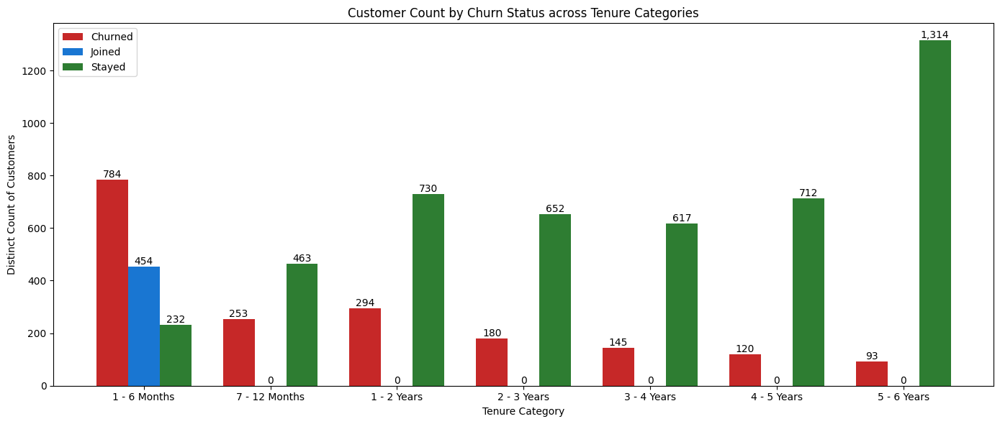

In [69]:
count_df = df.groupby(['Tenure Category', 'Customer Status']).size().unstack(fill_value=0)
# Prepare data
categories = count_df.index
statuses = count_df.columns
x = np.arange(len(categories))      # positions for tenure categories
width = 0.25                         # width of each bar

plt.figure(figsize=(14,6))

# Plot each churn status as a separate bar group
for i, status in enumerate(statuses):
    bars = plt.bar(
        x + i * width,
        count_df[status],
        width,
        label=status,
        color=color_map.get(status, '#999999')
    )

    # Add value labels on bars
    for bar in bars:
        height = bar.get_height()
        plt.text(
            bar.get_x() + bar.get_width() / 2,
            height,
            f'{int(height):,}',
            ha='center',
            va='bottom',
            fontsize=10
        )

# X-axis settings
plt.xticks(x + width, categories)
plt.xlabel('Tenure Category')
plt.ylabel('Distinct Count of Customers')
plt.title('Customer Count by Churn Status across Tenure Categories')

plt.legend()
plt.tight_layout()
plt.show()

**Insight:**
- **Churning Customers:** Most of the churning customers has only subscribed to the telecom company for a period of 1-6 months, which is a number of 784 customers. The number of churning customers significant decreases for customers with longer tenure of months than 1-6 months, and it can also be seen that the trend is constantly decreasing for churning customers from 1-2 years to 5-6 years.
- **Staying Customers:** Most of the staying customers which consists of 1314 customers have already subscribed to the telecom company for 5-6 years. There is no clear trend as the data for staying customers of 1-2 years to 4-5 years only ranges around 617-730 customers, before the sharp increase to 1314 customers for customers with 5-6 years subscribed.
- **Joining Customers:** All joining customers fall into the 1-6 months category, where it can be seen that all the customers are only subscribed to the telecom company for 3 months or less as a result from querying the data.

**Recommendation:**
- **Feedback Surveys:** It is crucial to receive feedback from the staying and joining customers in the tenure category of 1-6 months and review the price rates for their subscription to reduce churn rate.
- **Reward Programs:** Create loyalty programs, promotions or benefits for newer users to keep the engagement with customer base with good marketing efforts in order to reach these customers.



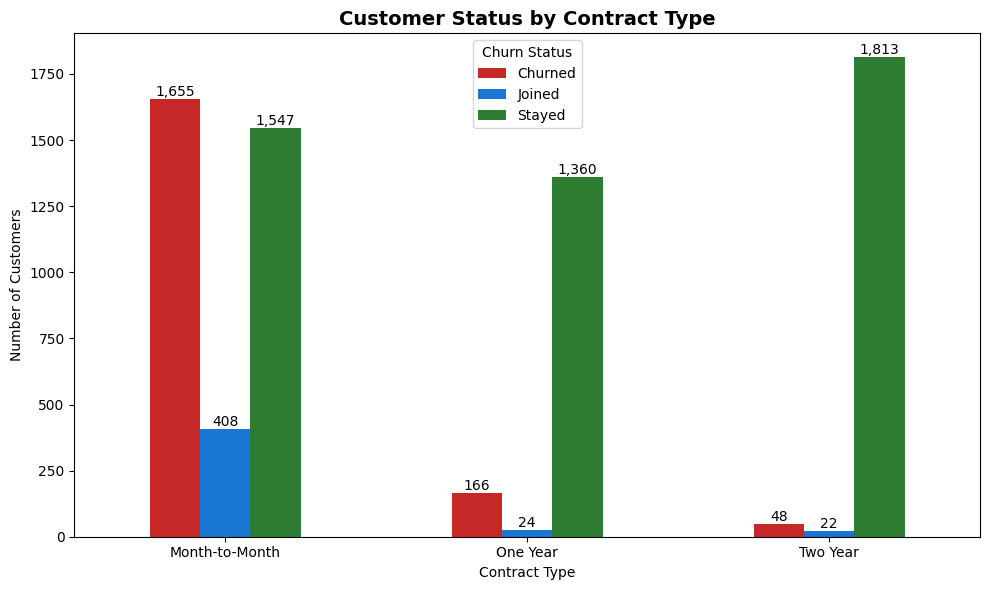

In [74]:
contract_status = df.groupby(['Contract', 'Customer Status']).size().unstack(fill_value=0)
ax = contract_status.plot(
    kind='bar',
    figsize=(10, 6),
    color=[color_map.get(c, '#999999') for c in contract_status.columns]
)

plt.title('Customer Status by Contract Type', fontsize=14, fontweight='bold')
plt.xlabel('Contract Type')
plt.ylabel('Number of Customers')
plt.xticks(rotation=0)
plt.legend(title='Churn Status')

for container in ax.containers:
    ax.bar_label(container, fmt='{:,.0f}', label_type='edge', fontsize=10)

plt.tight_layout()
plt.show()


**Insight:**

Month-to-Month Contract Popularity: It can be seen that 88.55% of the churned customers (1655 customers out of 1869 customers) are subscribed to the telecom company on a month-to-month contract, whereas the remaining 8.88% customers are subscribed on one-year contracts (166 customers) and 2.57% are subscribed on two-year contracts (48 customers).

**Conclusion:**

Importance of Flexibility: With month-to-month contracts, it is seen that month-to-month contracts are the main choice for customers so that they are more free to cancel their subscription switch providers if certain expectations of the phone/internet services by the customers offered are not achieved.

**Recommendations:**
- **Quality Control:** Performance of the services such as phone call quality and internet connection consistency must be maintained on a regular basis to meet the expectations and minimize the churn rate of the customer base.
- **Price rates of services:** The price rates for the quota of both phone services and internet services must be adjusted regularly to maintain competitiveness in the telecom market.

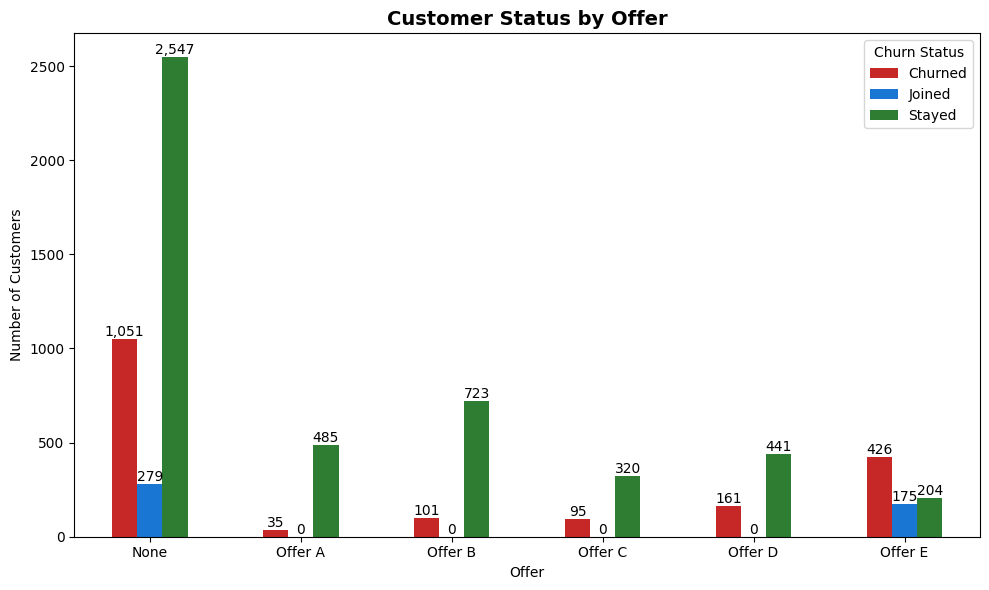

In [75]:
contract_status = df.groupby(['Offer', 'Customer Status']).size().unstack(fill_value=0)
ax = contract_status.plot(
    kind='bar',
    figsize=(10, 6),
    color=[color_map.get(c, '#999999') for c in contract_status.columns]
)

plt.title('Customer Status by Offer', fontsize=14, fontweight='bold')
plt.xlabel('Offer')
plt.ylabel('Number of Customers')
plt.xticks(rotation=0)
plt.legend(title='Churn Status')

for container in ax.containers:
    ax.bar_label(container, fmt='{:,.0f}', label_type='edge', fontsize=10)

plt.tight_layout()
plt.show()

C:\Users\ASUS\AppData\Local\Temp\ipykernel_11164\1191087486.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['Tenure Category', 'Offer'])


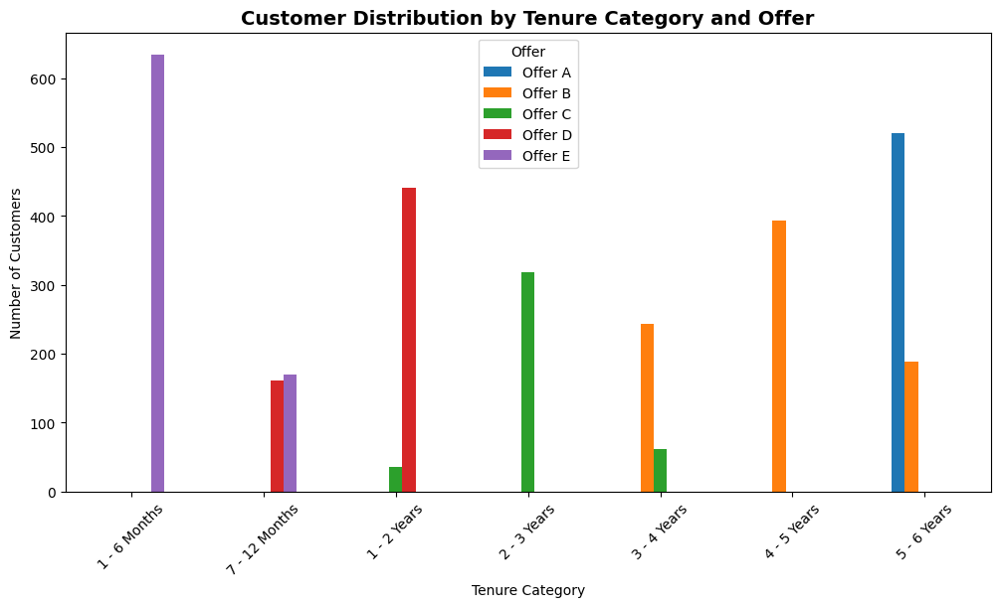

In [48]:
plot_df = (
    df
    .groupby(['Tenure Category', 'Offer'])
    .size()
    .reset_index(name='customer_count')
)
plot_df = plot_df[plot_df['Offer'] != 'None']
pivot_df = (
    plot_df
    .pivot(index='Tenure Category',
           columns='Offer',
           values='customer_count')
    .fillna(0)
)
pivot_df = pivot_df.reindex(tenure_order)
ax = pivot_df.plot(
    kind='bar',
    figsize=(12, 6)
)

plt.title('Customer Distribution by Tenure Category and Offer',
          fontsize=14, fontweight='bold')
plt.xlabel('Tenure Category')
plt.ylabel('Number of Customers')
plt.xticks(rotation=45)
plt.legend(title='Offer')

**Insight:**

**Offers Taken by Customers:** Out of the 1869 churning customers, 1051 customers are found to be subscribed to no offers. As for the remaining customers, the offer with the most churned customers are customers who subscribed to Offer E  with tenure of 1-6 months and 7-12 months churning from the telecom company. 

**Offer Subscribed Trend:** It is also observed that Offer A would be the oldest package offered to customers who had a tenure of 5-6 years subscribed to the telecom company, where customers with a shorter tenure does not seem to be subscribed to Offer A. As for Offer E, there are customers subscribed to it with tenures ranging from a month to a year, with newly joining customers subscribing as well. So Offer E may be a promotional package designed for newly subscribed customers.

**Recommendations:**

**Offer Benefits Review:** Out of all the customers that subscribe to offers who churned, almost half of that are subscribed to Offer E which is a newer offer. Thus, it is important to look into the price rates and quota of both phone and internet services before offering customers with the best deals.

**Marketing Scheme for Offers:** As majority of the customers who churned have not subscribed to any offers, marketing campaigns should be effectively carried out to push these offers to the customer base through social media and activities such as mall promotional events, sport competitions and marathons. These can also help to attract new customers as well as giving potential customers great experiences.

In [12]:
churned_df = df[df['Customer Status']=='Churned']

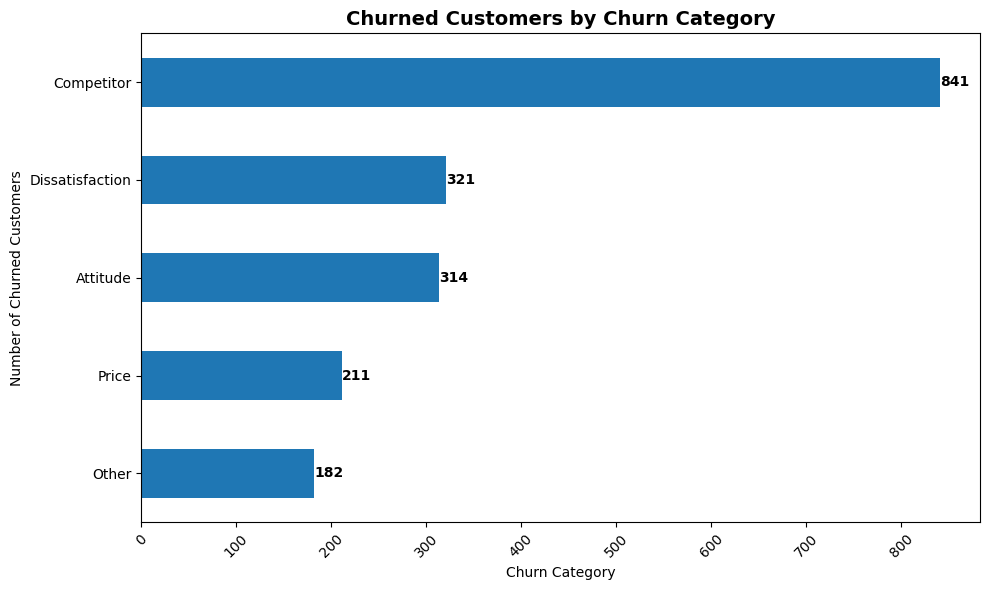

In [56]:

churn_category_count = (churned_df.groupby('Churn Category').size().sort_values()
)
ax = churn_category_count.plot(
    kind='barh',
    figsize=(10, 6)
)
for bar in ax.patches:
    width = bar.get_width()
    ax.text(
        width,
        bar.get_y() + bar.get_height() / 2,
        f'{width:,.0f}',
        va='center',
        ha='left',
        fontsize=10,
        fontweight='bold'
    )
plt.title('Churned Customers by Churn Category',
          fontsize=14, fontweight='bold')
plt.xlabel('Churn Category')
plt.ylabel('Number of Churned Customers')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

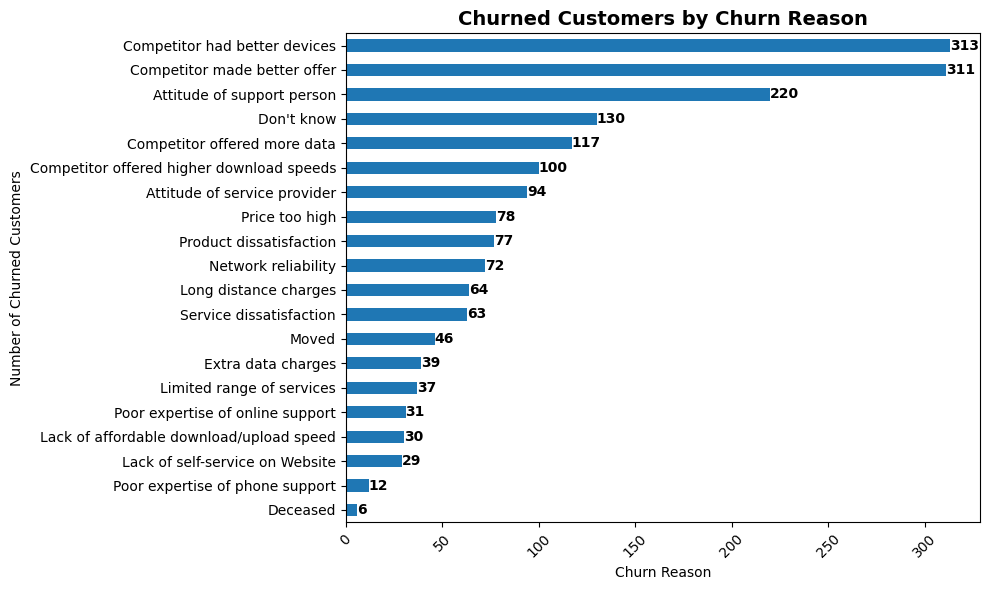

In [58]:
churn_reason_count = (churned_df.groupby('Churn Reason').size().sort_values()
)
ax = churn_reason_count.plot(
    kind='barh',
    figsize=(10, 6)
)
for bar in ax.patches:
    width = bar.get_width()
    ax.text(
        width,
        bar.get_y() + bar.get_height() / 2,
        f'{width:,.0f}',
        va='center',
        ha='left',
        fontsize=10,
        fontweight='bold'
    )
plt.title('Churned Customers by Churn Reason',
          fontsize=14, fontweight='bold')
plt.xlabel('Churn Reason')
plt.ylabel('Number of Churned Customers')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

**Main Issue of Competition:** Out of the 1869 total churning customers, it is found out that the top 5 churn reasons include "Competitor had better devices" (16.75%), "Competitor made better offer" (16.6%), "Attitude of support person" (11.8%), "Competitor offered more data" (6.2%) and "Competitor offered higher download speeds"(5.3%).

In [65]:
churn_reason_table = (
    churned_df
    .groupby([
        'Customer Status',
        'Phone Service',
        'Internet Service',
        'Churn Reason'
    ])
    .size()
    .reset_index(name='customer_count')
    .sort_values(
        by=['Phone Service', 'Internet Service', 'customer_count'],
        ascending=[False, False, False]
    )
)
churn_reason_table.reset_index()

,index,Customer Status,Phone Service,Internet Service,Churn Reason,customer_count
0,30,Churned,Yes,Yes,Competitor had better devices,280
1,31,Churned,Yes,Yes,Competitor made better offer,273
2,29,Churned,Yes,Yes,Attitude of support person,169
3,35,Churned,Yes,Yes,Don't know,118
4,33,Churned,Yes,Yes,Competitor offered more data,104
5,32,Churned,Yes,Yes,Competitor offered higher download speeds,87
6,28,Churned,Yes,Yes,Attitude of service provider,77
7,46,Churned,Yes,Yes,Product dissatisfaction,68
8,42,Churned,Yes,Yes,Network reliability,65
9,45,Churned,Yes,Yes,Price too high,64


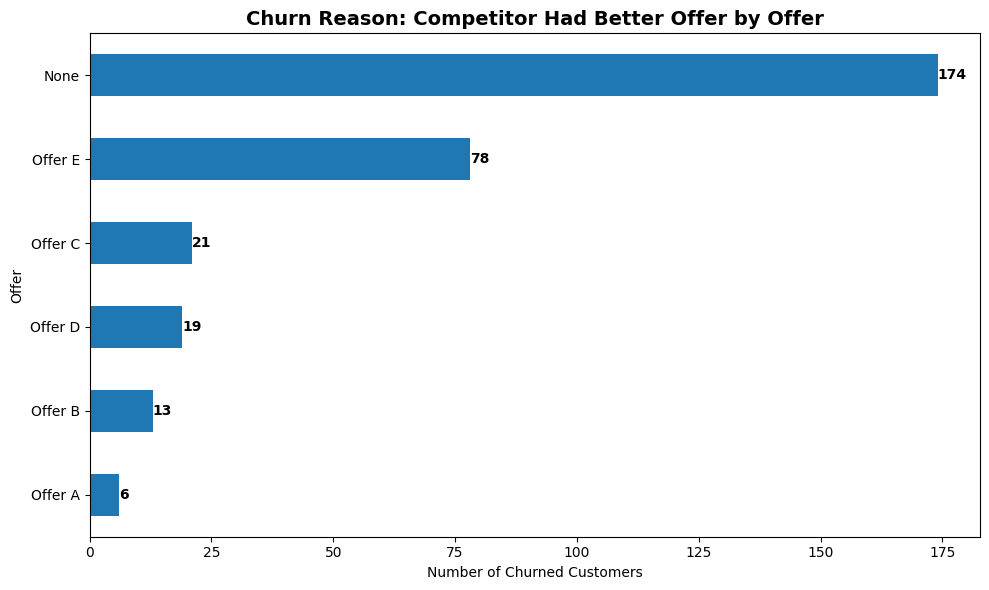

In [68]:
ax = (
    df[
        (df['Customer Status'] == 'Churned') &
        (df['Churn Reason'] == 'Competitor made better offer') 
    ]
    .groupby('Offer')
    .size()
    .sort_values()
    .plot(
        kind='barh',
        figsize=(10, 6)
    )
)

plt.title(
    'Churn Reason: Competitor Had Better Offer by Offer',
    fontsize=14,
    fontweight='bold'
)
plt.xlabel('Number of Churned Customers')
plt.ylabel('Offer')

for bar in ax.patches:
    width = bar.get_width()
    ax.text(
        width,
        bar.get_y() + bar.get_height() / 2,
        f'{width:,.0f}',
        va='center',
        ha='left',
        fontsize=10,
        fontweight='bold'
    )

plt.tight_layout()
plt.show()

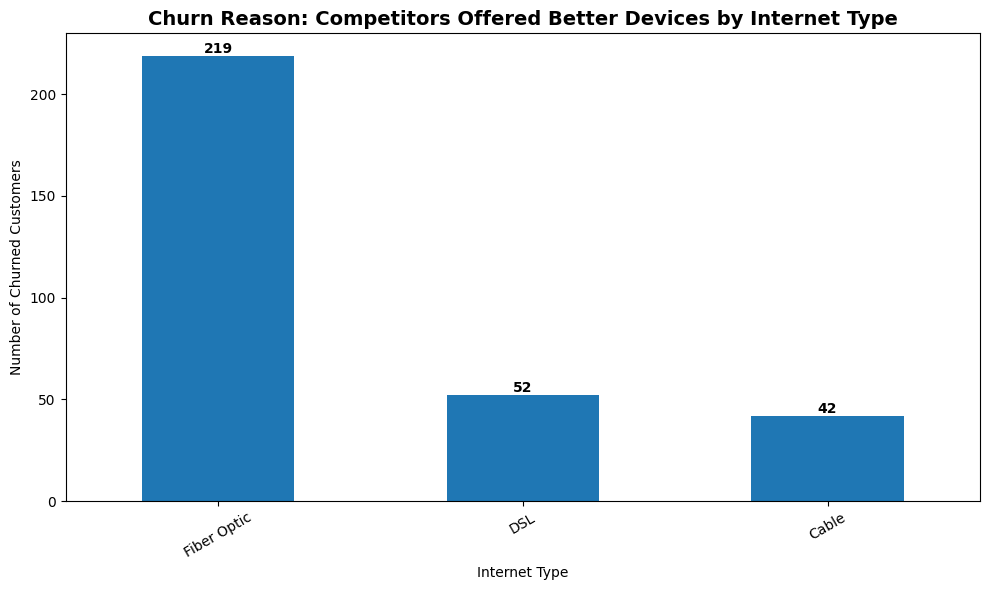

In [76]:
ax = (
    df[(df['Customer Status'] == 'Churned') & (df['Churn Reason'] == 'Competitor had better devices') ].groupby('Internet Type').size().sort_values(ascending=False)
    .plot(
        kind='bar',
        figsize=(10, 6)
    )
)

plt.title(
    'Churn Reason: Competitors Offered Better Devices by Internet Type',
    fontsize=14,
    fontweight='bold'
)
plt.xlabel('Internet Type')
plt.ylabel('Number of Churned Customers')
plt.xticks(rotation=30)

for bar in ax.patches:
    height = bar.get_height()
    ax.text(
        bar.get_x() + bar.get_width() / 2,
        height,
        f'{height:,.0f}',
        ha='center',
        va='bottom',
        fontsize=10,
        fontweight='bold'
    )

plt.tight_layout()
plt.show()

**Insight:**

**Popularity of Internet Types:** From the data observed above, it is seen that 70% of the churning customers (219 out of 313 customers) who got offered better devices from competitors use the fastest type of internet, which is the fiber optic, whereas the remaining 16.6% subscribes to DSL internet and 13.4% subscribers to cable internet.

**Recommendations:**

**High-Speed Internet Devices Offered to Customers:** Operating as a telecom company, it is important to provide customers with internet service that contains high-performing and fast internet. Thus, devices such as optical network terminals, modems and routers with updated techonologies should be offered to customers who are subscribed to internet services. Aside from that, regular maintenance shall also be carried out in order for customer to get the best experience

In [10]:
outliers_avg_monthly_gb_download[outliers_avg_monthly_gb_download ['Churn Reason']== 'Competitor offered higher download speeds' ]

,Customer ID,Gender,Age,Married,Number of Dependents,City,Zip Code,Latitude,Longitude,Number of Referrals,...,Monthly Charge,Total Charges,Total Refunds,Total Extra Data Charges,Total Long Distance Charges,Total Revenue,Customer Status,Churn Category,Churn Reason,Population
248,0376-YMCJC,Male,21,No,0,Novato,94949,38.067204,-122.524004,0,...,90.60,1943.20,4.73,0,889.87,2828.34,Churned,Competitor,Competitor offered higher download speeds,13361
1074,1565-RHDJD,Female,21,No,0,Palo Cedro,96073,40.582399,-122.195512,0,...,84.05,333.55,0.00,0,166.88,500.43,Churned,Competitor,Competitor offered higher download speeds,4931
1139,1678-FYZOW,Female,28,No,0,Sacramento,95835,38.685069,-121.543709,0,...,79.40,244.65,0.00,0,139.80,384.45,Churned,Competitor,Competitor offered higher download speeds,854
1854,2691-NZETQ,Male,28,No,0,San Jose,95130,37.277592,-121.986477,0,...,85.35,758.60,0.00,0,442.26,1200.86,Churned,Competitor,Competitor offered higher download speeds,13481
2045,2951-QOQTK,Male,28,No,0,Sacramento,95815,38.608405,-121.449942,0,...,80.80,332.45,0.00,0,169.32,501.77,Churned,Competitor,Competitor offered higher download speeds,25355
2403,3440-JPSCL,Female,26,No,0,Sonoma,95476,38.254850,-122.461799,0,...,99.95,547.65,0.00,0,30.96,578.61,Churned,Competitor,Competitor offered higher download speeds,34314
2975,4250-ZBWLV,Male,24,No,0,Olema,94950,38.052209,-122.775567,0,...,108.45,7176.55,9.68,0,1478.32,8645.19,Churned,Competitor,Competitor offered higher download speeds,248
4238,5980-NOPLP,Female,19,Yes,0,Pasadena,91105,34.139460,-118.166649,4,...,96.10,4364.10,0.00,0,494.56,4858.66,Churned,Competitor,Competitor offered higher download speeds,10253
4938,6956-SMUCM,Female,29,No,0,Miranda,95553,40.210895,-123.860000,0,...,99.00,287.40,0.00,10,100.17,397.57,Churned,Competitor,Competitor offered higher download speeds,867
5486,7721-JXEAW,Male,23,Yes,0,Elk Grove,95624,38.434138,-121.305870,1,...,41.05,2452.70,0.00,0,0.00,2452.70,Churned,Competitor,Competitor offered higher download speeds,38534


In [53]:
churned_outlier_dowload_df = outliers_avg_monthly_gb_download[outliers_avg_monthly_gb_download['Customer Status']=='Churned']
len(churned_outlier_dowload_df)

147

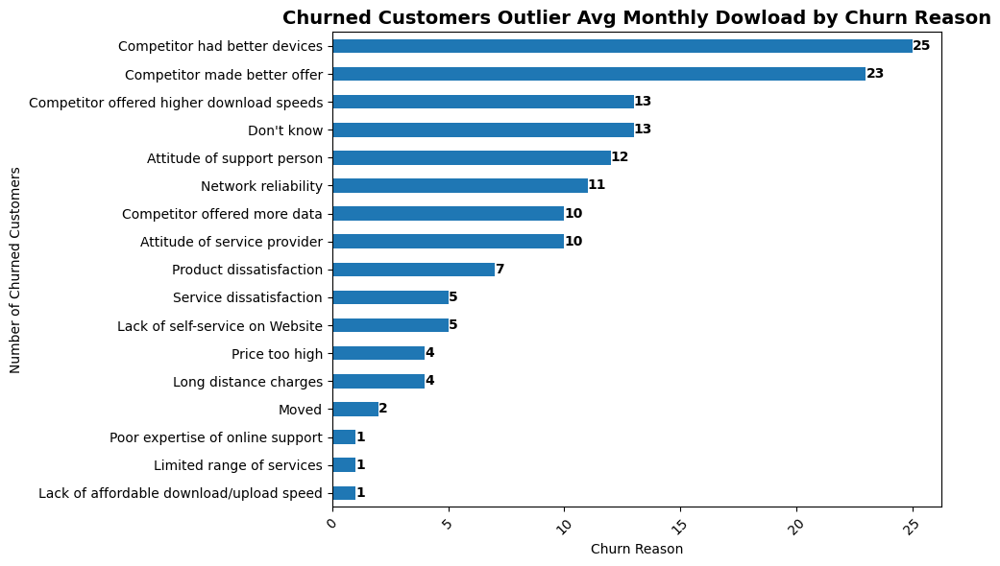

In [22]:

churn_reason_count = (churned_outlier_dowload_df.groupby('Churn Reason').size().sort_values()
)
ax = churn_reason_count.plot(
    kind='barh',
    figsize=(10, 6)
)
for bar in ax.patches:
    width = bar.get_width()
    ax.text(
        width,
        bar.get_y() + bar.get_height() / 2,
        f'{width:,.0f}',
        va='center',
        ha='left',
        fontsize=10,
        fontweight='bold'
    )
plt.title('Churned Customers Outlier Avg Monthly Download by Churn Reason',
          fontsize=14, fontweight='bold')
plt.xlabel('Churn Reason')
plt.ylabel('Number of Churned Customers')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

**Insight:**

Customers with high download demand (outliers in average monthly GB download) : Out of 147 churned customers in this segment, 25 left due to competitors offering better devices, and 23 left because competitors provided better offers. 

**Recommandations:**

This suggests a need to review and upgrade device offerings, improve promotional packages, and collaborate with the customer care team to proactively recommend more suitable offers to customers with high download needs.

In [44]:

churned_customer_vip_df = customer_vip[customer_vip ['Customer Status']=='Churned']
churned_customer_vip_df

,Customer ID,Gender,Age,Married,Number of Dependents,City,Zip Code,Latitude,Longitude,Number of Referrals,...,Total Charges,Total Refunds,Total Extra Data Charges,Total Long Distance Charges,Total Revenue,Customer Status,Churn Category,Churn Reason,Population,Tenure Category
2003,2889-FPWRM,Male,31,Yes,0,Mckinleyville,95519,40.965011,-124.015255,1,...,8684.8,0.0,0,2510.64,11195.44,Churned,Competitor,Competitor offered higher download speeds,15921,5 - 6 Years


**Insights:**

Within the VIP customer segment (outliers in total revenue), which represents high-value customers contributing significantly to the company’s revenue, only one customer churned. The churn reason for this customer was that a competitor offered higher download speeds.

**Recommendations:**

Although churn within the VIP segment is minimal, this case highlights the importance of maintaining competitive network performance for high-value customers. It is recommended to prioritize VIP customers for speed upgrades, offer exclusive high-speed plans, and proactively monitor their service satisfaction. Additionally, the customer care team should conduct targeted retention outreach to VIP customers to ensure their needs are met before competitors gain an advantage.

## Conclusion 

**Tenure of Months and Offers Taken by Churning Customers**: Most of the churning customers has only subscribed to the telecom company for a period of 1-6 months, which is a number of 784 customers out of 1869 churning customers. Furthermore, out of the 1869 churning customers, 1051 customers are found to be subscribed to no offers, where most of the customers have a tenure of 1-6 months (417 customers). For the churning customers with offers, Offer E has the most churning customers, where 367 customers with tenure of 1-6 months and 59 customers with tenure of 7-12 months churning from the telecom company.

**Main Issue of Competition**: Out of the 1869 total churning customers, it is found out that the top 5 churn reasons include "Competitor had better devices" (16.75%), "Competitor made better offer" (16.6%), "Attitude of support person" (11.8%), "Competitor offered more data" (6.2%) and "Competitor offered higher download speeds"(5.3%).

## Recommendations

**Offer Benefits Review:** It is important to look into the price rates and quota of both phone and internet services before offering customers with the best deals. The quota for phone calls and internet data must be reviewed and provided sufficiently to customers. For example, considering that Offer E has the most churning customers aside from those with no offers, although customers subscribed to Offer E had the lowest amount of monthly charges.

**Continuation of older offers:** Older offers such as Offer A, B, C and D which seem to be discontinued could be resumed as it is seen to have lesser churning customers than the newer Offer E, though it is also important to review the quotas and price rates of these offers based on market conditions.

**Marketing Scheme for Offers:** As majority of the customers who churned have not subscribed to any offers, marketing campaigns should be effectively carried out to push these offers to the customer base through social media and activities such as mall promotional events, sport competitions and marathons. These can also help to attract new customers as well as giving potential customers great experiences.

**Reward Programs:** Create loyalty programs for customers with longer tenures, promotions or benefits such as collaborations with food delivery companies to give out food vouches for newer users to keep the engagement with customer base with good marketing efforts in order to reach these customers.

**Choice of High-Quality Devices Offered:** While it is seen that most of the customers use these streaming platforms, it is possible to offer physical devices such as smart TVs, smart tablets or even smart phones that can come as a package together with high-speed internet subscriptions which may appeal to these customers. The telecom company can also provide their own TV, movie or music streaming platforms, though it is important to include a wide variety of choices for the customers. As an alternative, the telecom company can also form partnerships with these third-party streaming companies to provide their subscribers with offers such as offer-exclusive prices or free streaming memberships within a fixed period of time.

**Training programs for support staff:** Programs such as monthly evaluation shall be carried out by the human resources team as well as proper training regimes for verbal communication should be done.